In [2]:
import pandas as pd
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

In [3]:
airbnb_df = pd.read_csv('./Dataset/Airbnb/cleaned_airbnb_dataset.csv')

In [4]:
# Set seaborn style
sns.set(style="whitegrid")

In [5]:
airbnb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33913 entries, 0 to 33912
Data columns (total 41 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   name                            33913 non-null  object 
 1   description                     33913 non-null  object 
 2   host_since                      33913 non-null  object 
 3   host_response_time              33913 non-null  object 
 4   host_response_rate              33913 non-null  object 
 5   host_acceptance_rate            33913 non-null  object 
 6   host_is_superhost               33913 non-null  object 
 7   host_verifications              33913 non-null  object 
 8   host_has_profile_pic            33913 non-null  object 
 9   host_identity_verified          33913 non-null  object 
 10  latitude                        33913 non-null  float64
 11  longitude                       33913 non-null  float64
 12  property_type                   

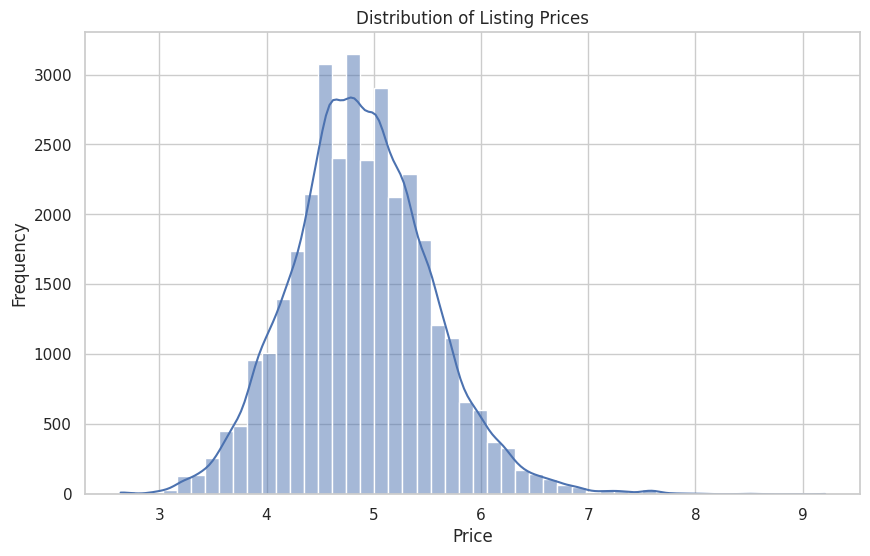

In [6]:

#Distribution of Listing Prices
plt.figure(figsize=(10, 6))
sns.histplot(airbnb_df['price'], bins=50, kde=True)
plt.title('Distribution of Listing Prices')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

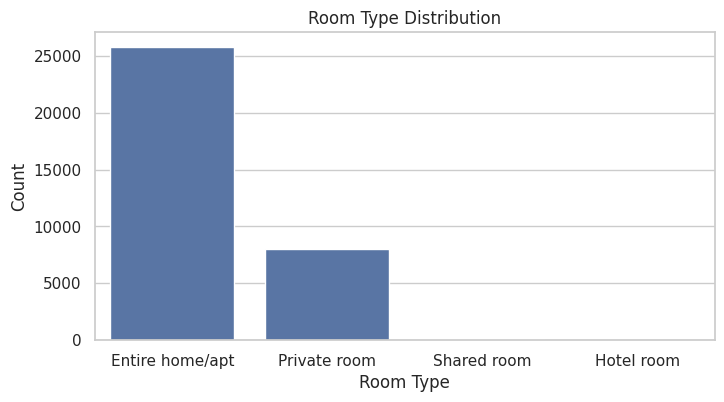

In [7]:
#Room Type Distribution
plt.figure(figsize=(8, 4))
room_type_counts = airbnb_df['room_type'].value_counts()
sns.barplot(x=room_type_counts.index, y=room_type_counts.values)
plt.title('Room Type Distribution')
plt.xlabel('Room Type')
plt.ylabel('Count')
plt.show()

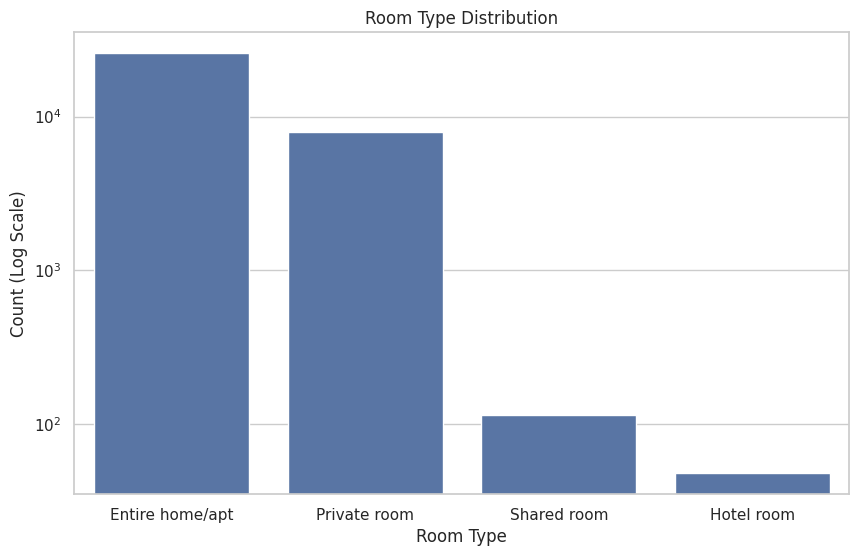

In [22]:
# Room Type Distribution with Log Scale
plt.figure(figsize=(10, 6))
room_type_counts = airbnb_df['room_type'].value_counts()
sns.barplot(x=room_type_counts.index, y=room_type_counts.values)
plt.yscale('log')
plt.title('Room Type Distribution')
plt.xlabel('Room Type')
plt.ylabel('Count (Log Scale)')
plt.show()

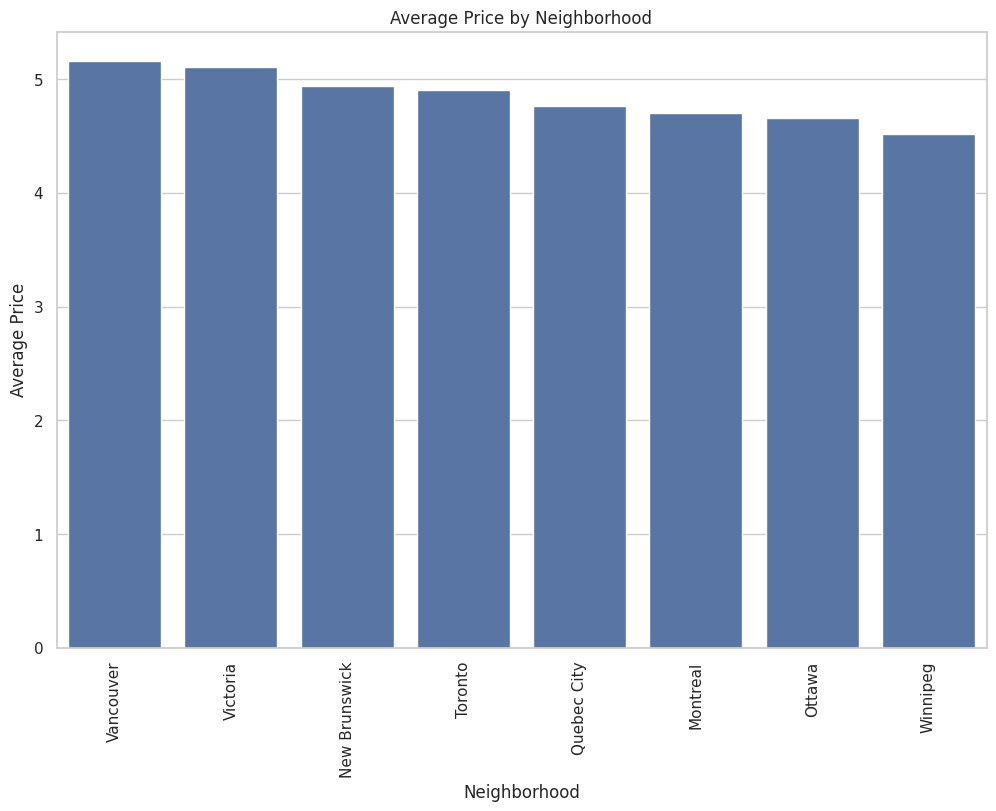

In [17]:
#Average Price by Neighborhood
plt.figure(figsize=(12, 8))
neighborhood_prices = airbnb_df.groupby('City')['price'].mean().sort_values(ascending=False)
sns.barplot(x=neighborhood_prices.index, y=neighborhood_prices.values)
plt.xticks(rotation=90)
plt.title('Average Price by Neighborhood')
plt.xlabel('Neighborhood')
plt.ylabel('Average Price')
plt.show()


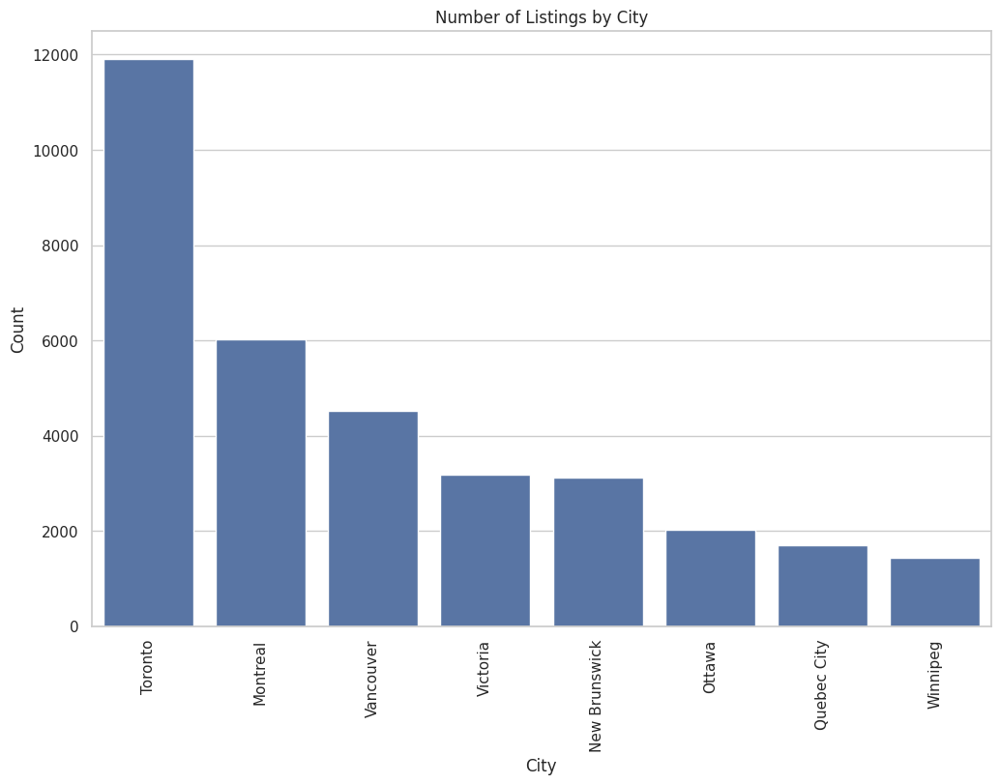

In [16]:
# Plot the number of listings by city
plt.figure(figsize=(12, 8))
sns.countplot(x='City', data=airbnb_df, order=airbnb_df['City'].value_counts().index)
plt.title('Number of Listings by City')
plt.xlabel('City')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

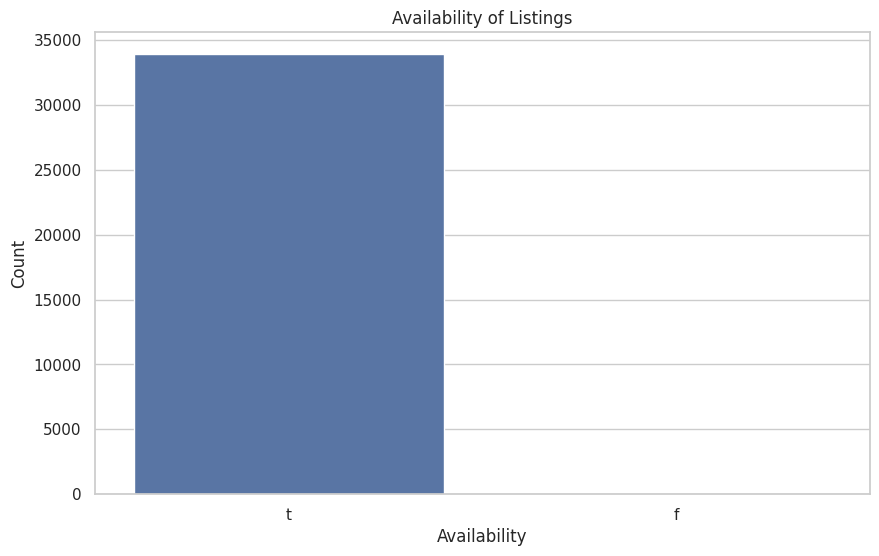

In [51]:
plt.figure(figsize=(10, 6))
availability_counts = airbnb_df['has_availability'].value_counts()
sns.barplot(x=availability_counts.index, y=availability_counts.values)
plt.title('Availability of Listings')
plt.xlabel('Availability')
plt.ylabel('Count')
plt.show()

In [42]:
availability_counts = airbnb_df['has_availability'].value_counts()
availability_counts

has_availability
t    33909
f        4
Name: count, dtype: int64

We can delete 'has_availability' column as only 4 value are false and 33909 are true.

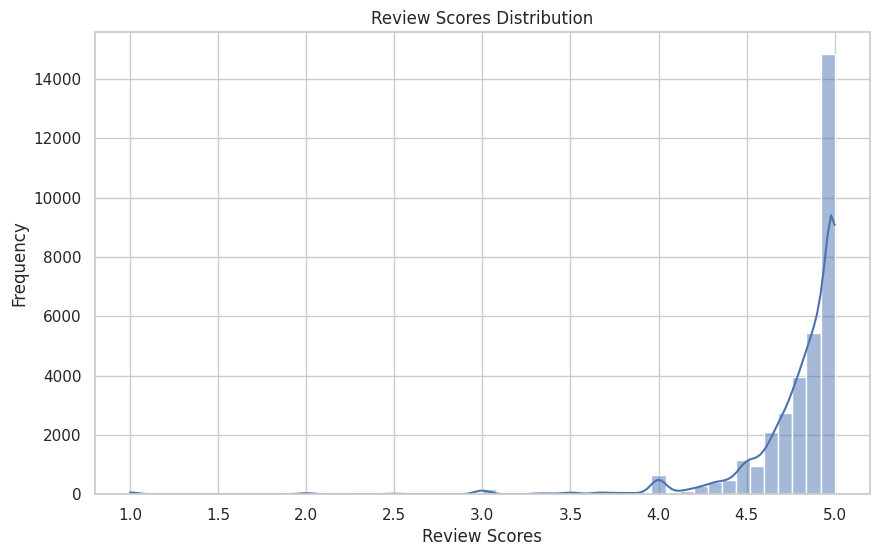

In [25]:
# Review Scores Distribution
plt.figure(figsize=(10, 6))
sns.histplot(airbnb_df['review_scores_rating'], bins=50, kde=True)
plt.title('Review Scores Distribution')
plt.xlabel('Review Scores')
plt.ylabel('Frequency')
plt.show()

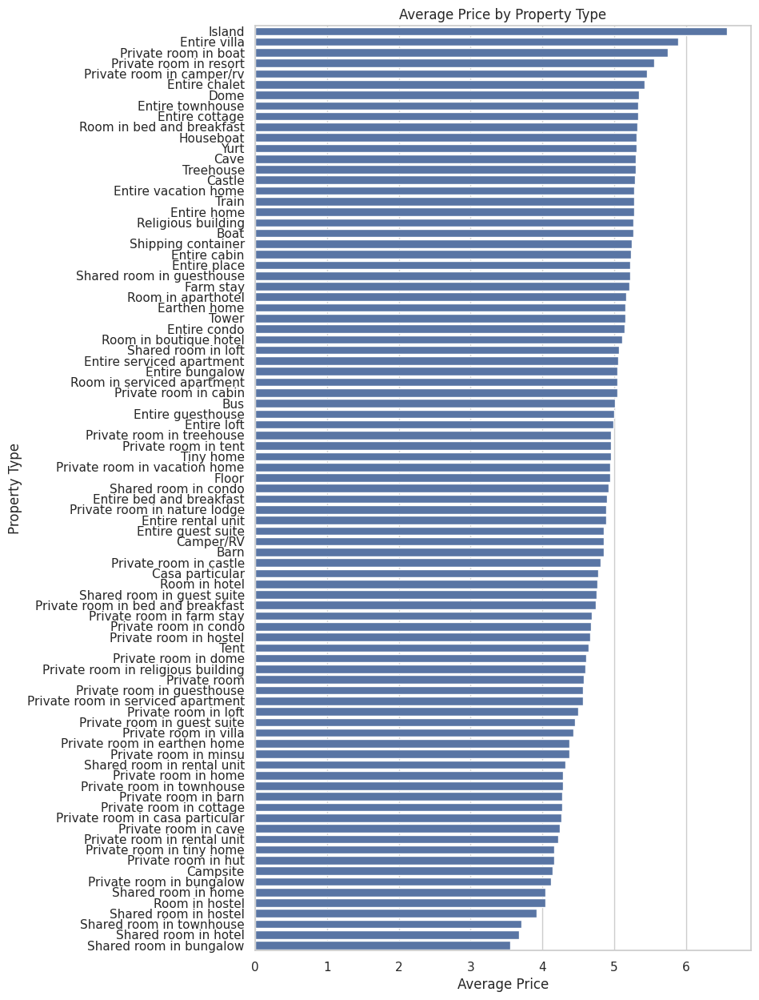

In [34]:
# Average Price by Property Type
plt.figure(figsize=(8, 15))
property_type_prices = airbnb_df.groupby('property_type')['price'].mean().sort_values(ascending=False)
sns.barplot(y=property_type_prices.index, x=property_type_prices.values, orient='h')
plt.title('Average Price by Property Type')
plt.xlabel('Average Price')
plt.ylabel('Property Type')
plt.show()

In [38]:
# Initialize the map centered around an average location
map_center = [airbnb_df['latitude'].mean(), airbnb_df['longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=12)

# Add a marker cluster to the map
marker_cluster = MarkerCluster().add_to(m)

# Add points to the marker cluster
for idx, row in airbnb_df.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=f"Price: ${row['price']}<br>Room Type: {row['room_type']}").add_to(marker_cluster)

# Save the map to an HTML file
m.save('airbnb_map.html')

# To display the map
m

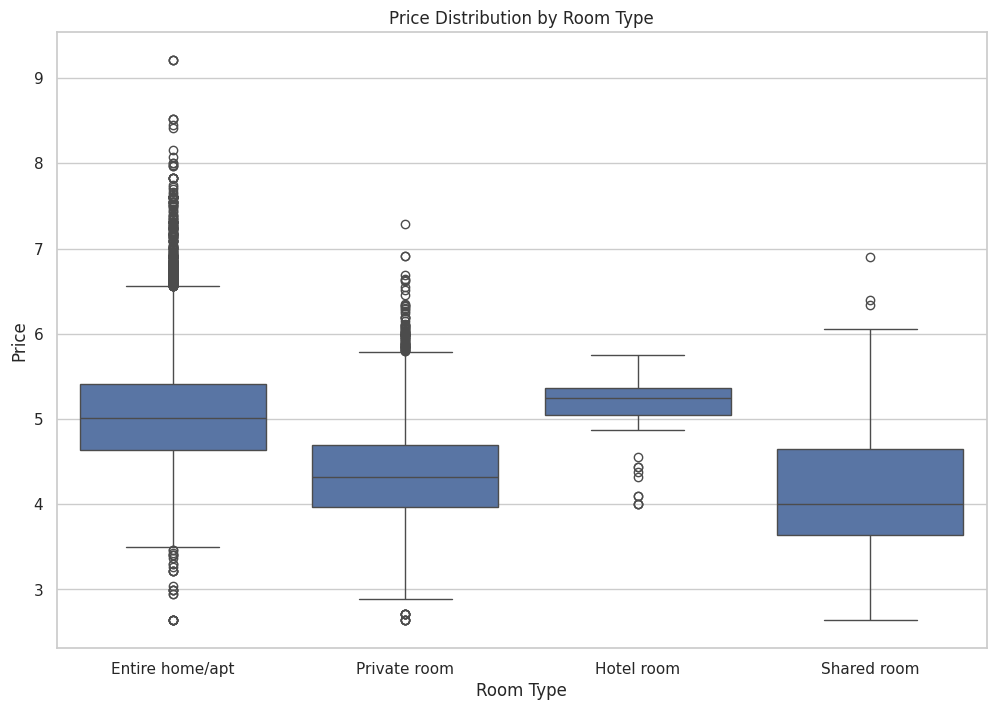

In [45]:
# distribution of prices across different room types.
plt.figure(figsize=(12, 8))
sns.boxplot(x='room_type', y='price', data=airbnb_df)
plt.title('Price Distribution by Room Type')
plt.xlabel('Room Type')
plt.ylabel('Price')
plt.show()

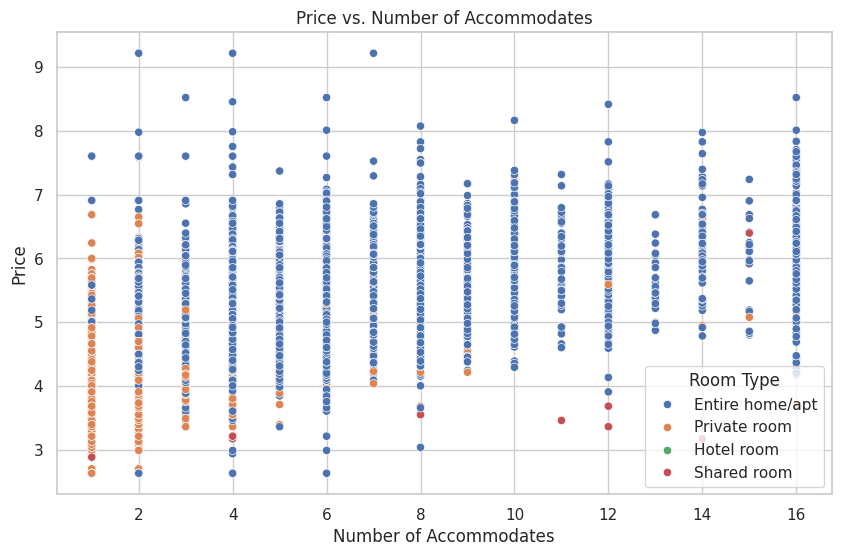

In [29]:
#relationship between the price and the number of reviews.
plt.figure(figsize=(10, 6))
sns.scatterplot(x='accommodates', y='price', data=airbnb_df, hue='room_type')
plt.title('Price vs. Number of Accommodates')
plt.xlabel('Number of Accommodates')
plt.ylabel('Price')
plt.legend(title='Room Type')
plt.show()

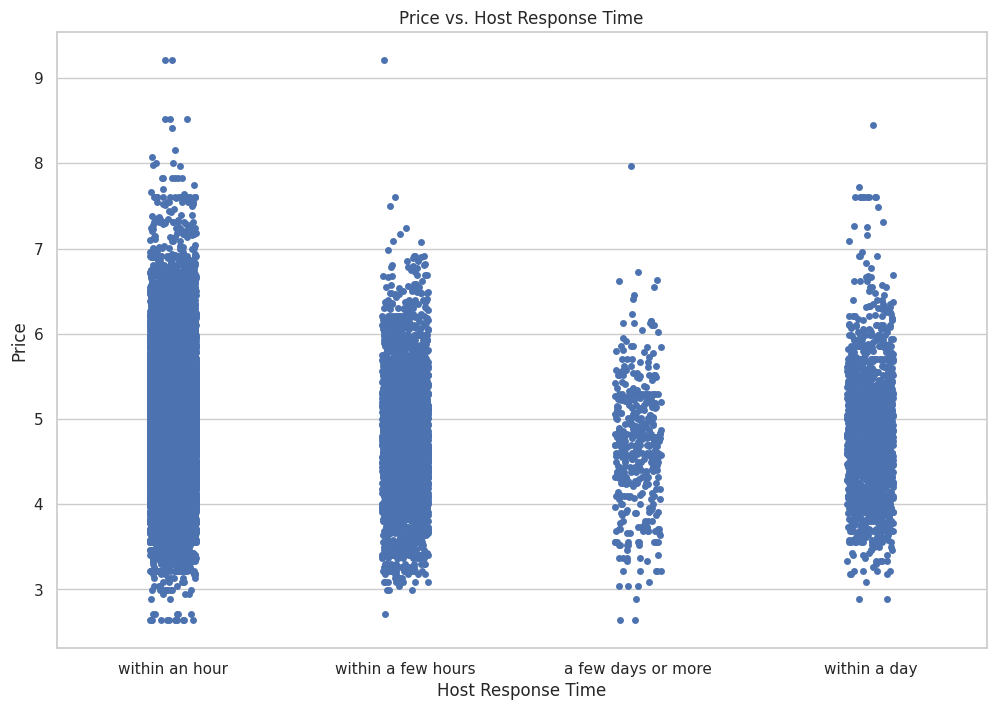

In [58]:
plt.figure(figsize=(12, 8))
sns.stripplot(x='host_response_time', y='price', data=airbnb_df, jitter=True)
plt.title('Price vs. Host Response Time')
plt.xlabel('Host Response Time')
plt.ylabel('Price')
plt.show()

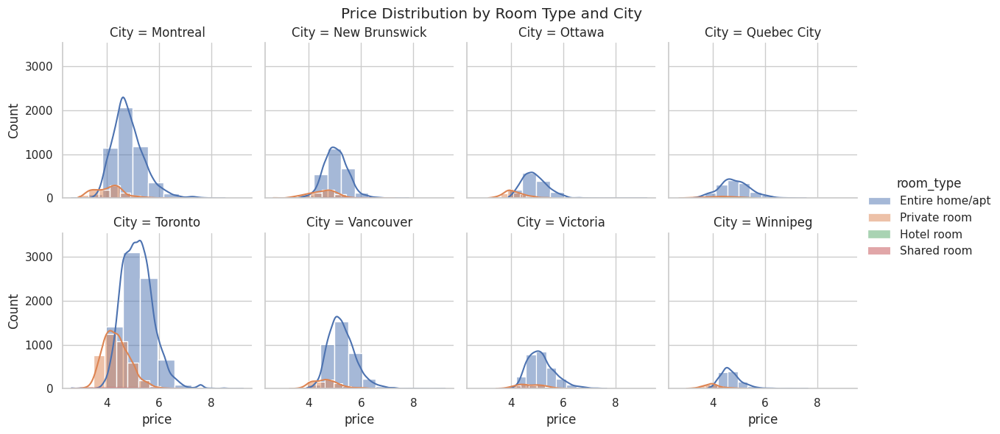

In [79]:
# FacetGrid for price distribution by room type and city
g = sns.FacetGrid(airbnb_df, col="City", hue="room_type", col_wrap=4, height=3)
g.map(sns.histplot, "price", bins=10, kde=True)
g.add_legend()
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Price Distribution by Room Type and City')
plt.show()

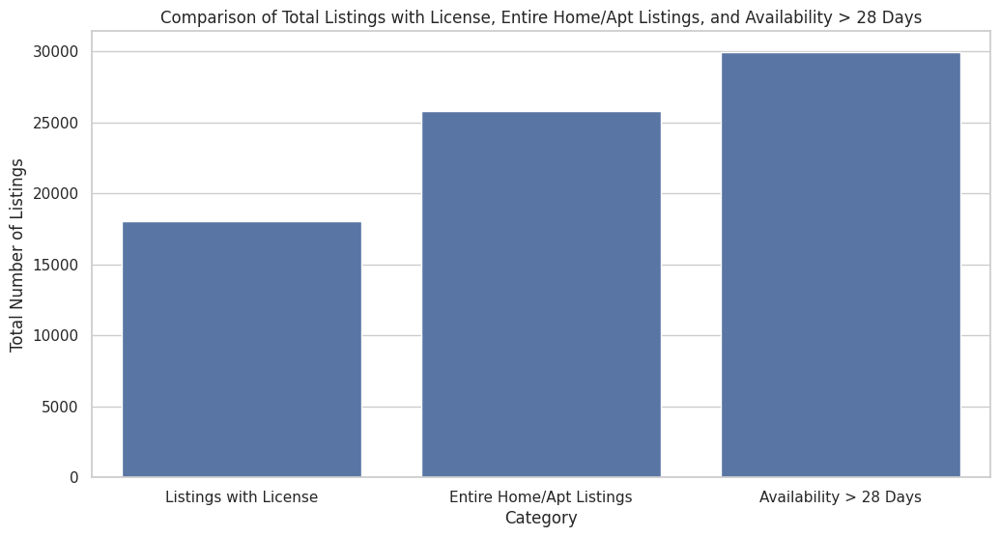

In [12]:

# Calculate the totals
total_listings_with_license = airbnb_df[airbnb_df['license'] != 'Unlicensed'].shape[0]
total_entire_home_apt = airbnb_df[airbnb_df['room_type'] == 'Entire home/apt'].shape[0]
total_availability_gt_28 = airbnb_df[airbnb_df['availability_365'] > 28].shape[0]

# Create a DataFrame for plotting
comparison_df = pd.DataFrame({
    'Category': ['Listings with License', 'Entire Home/Apt Listings', 'Availability > 28 Days'],
    'Total': [total_listings_with_license, total_entire_home_apt, total_availability_gt_28]
})

# Plot the data
plt.figure(figsize=(12, 6))
sns.barplot(x='Category', y='Total', data=comparison_df)
plt.title('Comparison of Total Listings with License, Entire Home/Apt Listings, and Availability > 28 Days')
plt.xlabel('Category')
plt.ylabel('Total Number of Listings')
plt.show()